In [1]:
import sys
sys.path.append('/mnt/d/ariel2/code/core/')
sys.path.append('d:/ariel2/code/core/')
sys.path.append('/kaggle/input/my-ariel2-library')
import kaggle_support as kgs
import ariel_model
import ariel_simple
import ariel_gp
import ariel_load
import ariel_load_FGS
import ariel_pca
import os
import numpy as np
import matplotlib.pyplot as plt
import copy
import importlib
from tqdm import tqdm
import seaborn as sns
import pandas as pd
kgs.debugging_mode = 1
kgs.profiling=False
kgs.n_workers = 4

import warnings
warnings.filterwarnings(
    "ignore",
    message=r".*use_inf_as_na option is deprecated.*",
    category=FutureWarning,
)

local


In [2]:
# Parameters in GP
# 0: 0 t0
# 1: 1 t0
# 2: alpha
# 3: beta
# 4: i
# 5: 0 u0 
# 6: 1 u0
# 7: 0 u1
# 8: 1 u1
# 9: 1 us0
# 10:1 us1

# Parameters in simple
# 0: 0 t0
# 1: alpha
# 2: beta
# 3: i
# 4: 0 rp
# 5: 0 u0
# 6: 0 u1
# 7: 1 rp
# 8: 1 u0
# 9: 1 u1
# 9-xx: poly
# -1: 1 t0

In [3]:
def remove_outlier(mat, threshold):
    mat_orig = copy.deepcopy(mat)
    inds = np.arange(mat.shape[0])
    while True:
        mu = np.mean(mat,0)
        std = np.std(mat,0)
        scaled = np.abs(mat-mu)/std
        #plt.figure()
        #plt.plot(scaled)
        if np.max(scaled)>threshold:
            max_per_row = np.max(scaled,1)
            to_remove = np.argmax(max_per_row)
            mat = np.delete(mat,to_remove,0)
            inds = np.delete(inds,to_remove)
        else:
            break
    assert np.all(mat == mat_orig[inds,:])
    return mat, inds

In [4]:
train_data = kgs.load_all_train_data()
train_data2 = train_data
train_data = train_data[:100]

In [5]:
importlib.reload(ariel_gp)
importlib.reload(ariel_pca)
model = ariel_model.baseline_model()
model = model.model
model.model.model_options.output_model = True
model.model.model_options.use_training_labels = True
model.model.model_options.n_samples_sigma_est = 2
model.train(train_data)

In [6]:
modelr = copy.deepcopy(model)
modelr.model.model_options.n_iter = 0
modelr.model.run_in_parallel = False
modelr.infer(train_data[0:1]);

In [7]:
data = copy.deepcopy(train_data)

Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [35:07<00:00,  1.92s/it]


local
SpawnPoolWorker-4 4
CUDA_VISIBLE_DEVICES= 0
New solver/alternative transit parameters fallback for planet id 155501234
New solver/alternative transit parameters fallback for planet id 205266886
New solver/alternative transit parameters fallback for planet id 291916399
New solver/alternative transit parameters fallback for planet id 691402002
New solver/alternative transit parameters fallback for planet id 1053204615
New solver/alternative transit parameters fallback for planet id 1293223638
New solver/alternative transit parameters fallback for planet id 1311109479
New solver/alternative transit parameters fallback for planet id 1370040003
New solver/alternative transit parameters fallback for planet id 1834181716
New solver/alternative transit parameters fallback for planet id 2074730139
New solver/alternative transit parameters fallback for planet id 2254664280
New solver/alternative transit parameters fallback for planet id 2562716556
New solver/alternative transit parameters 

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


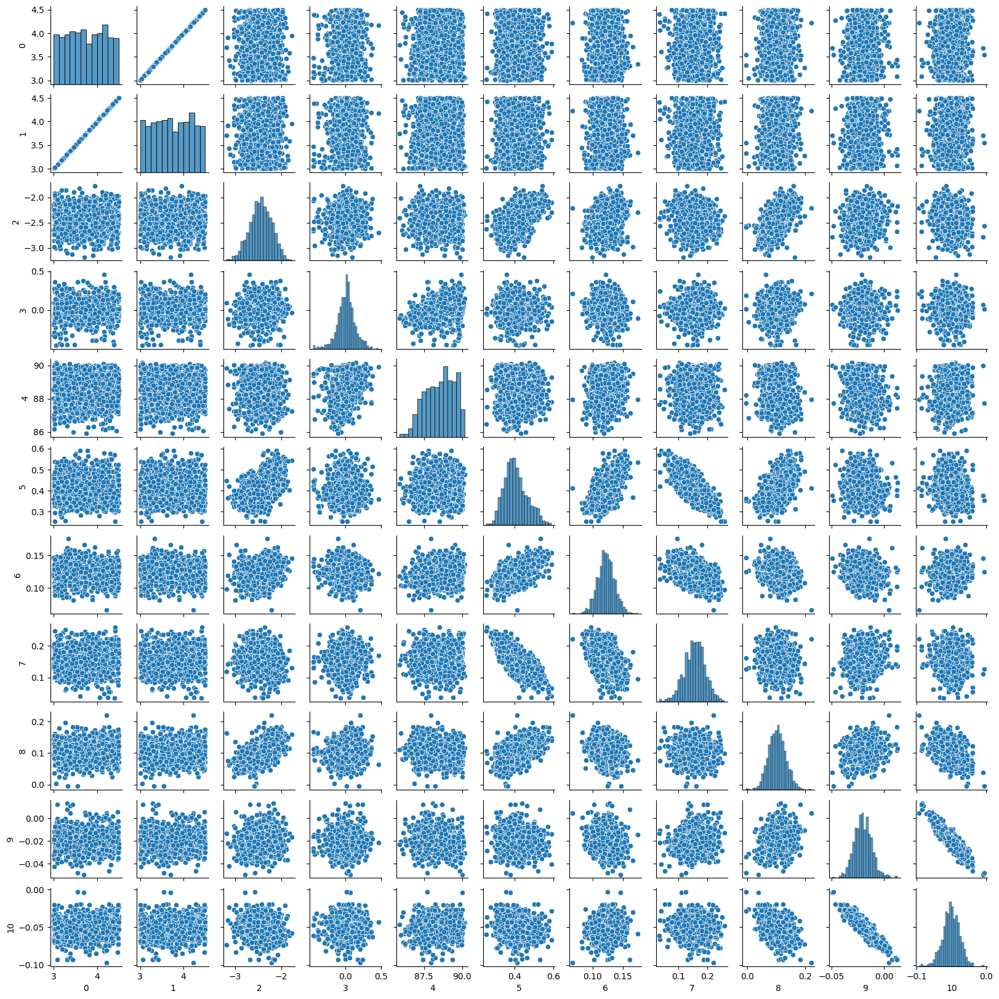

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


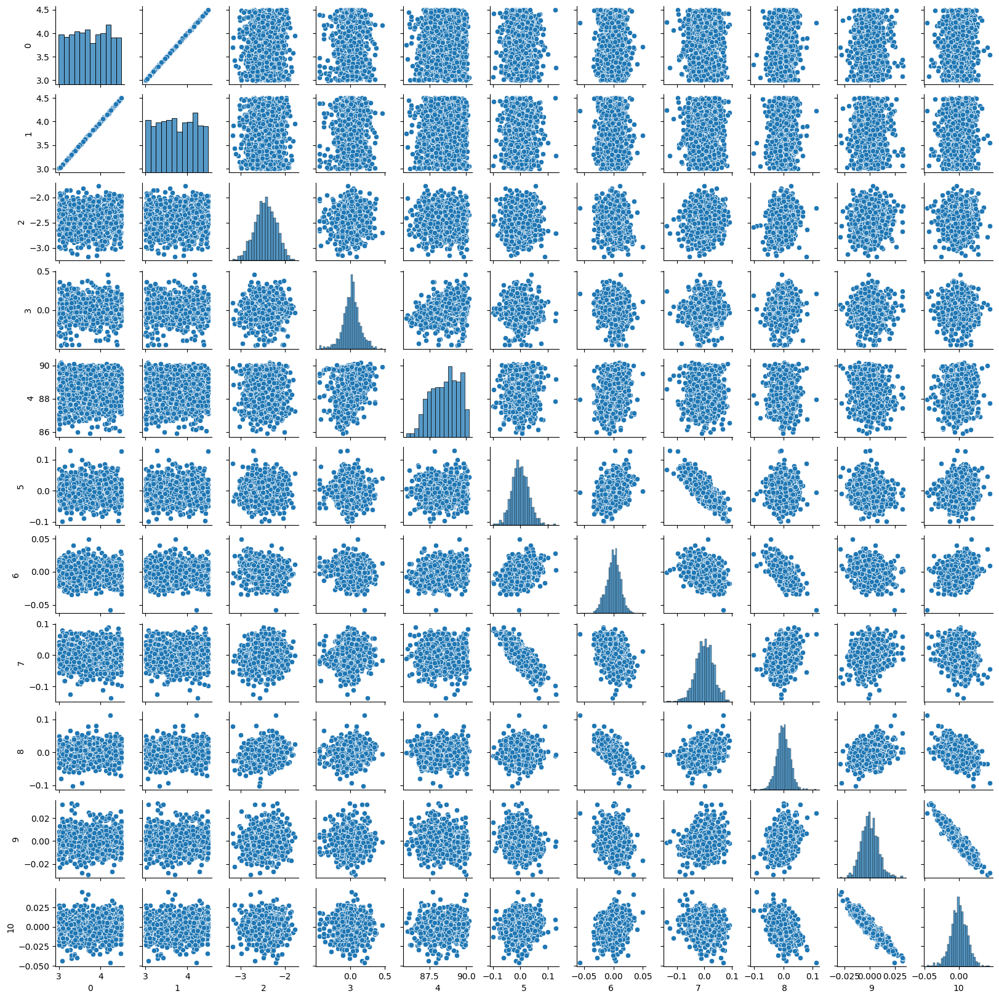

[0.43310887 0.43290936 0.23596294 0.12442554 0.93765027 0.03076109
 0.01207215 0.03230917 0.02293143 0.00861409 0.01185589]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95250805e-05 -1.46409859e-05  3.14672731e-05
 -3.79787233e-05 -2.81033722e-07  5.64673928e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:57<00:00,  1.58s/it]


local
SpawnPoolWorker-5 5
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-6 6
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-8 8
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-7 7
CUDA_VISIBLE_DEVICES= 0
(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


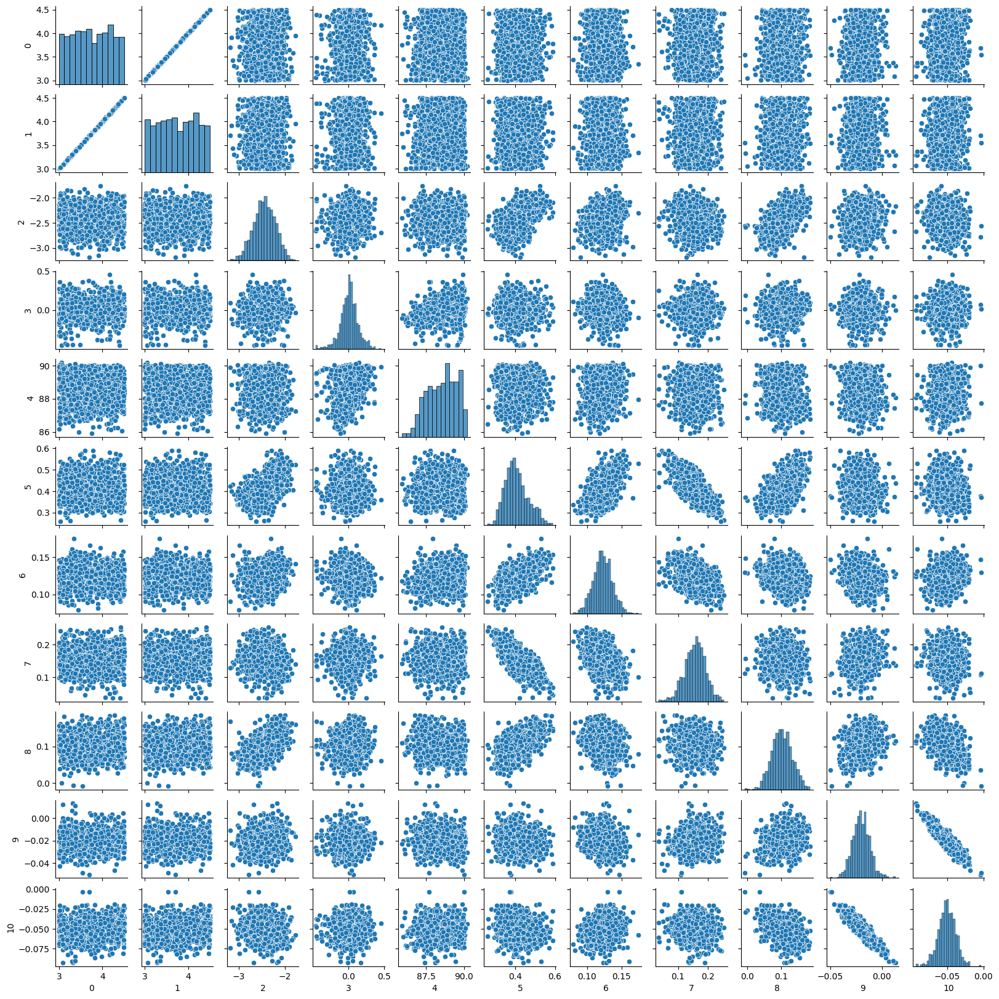

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


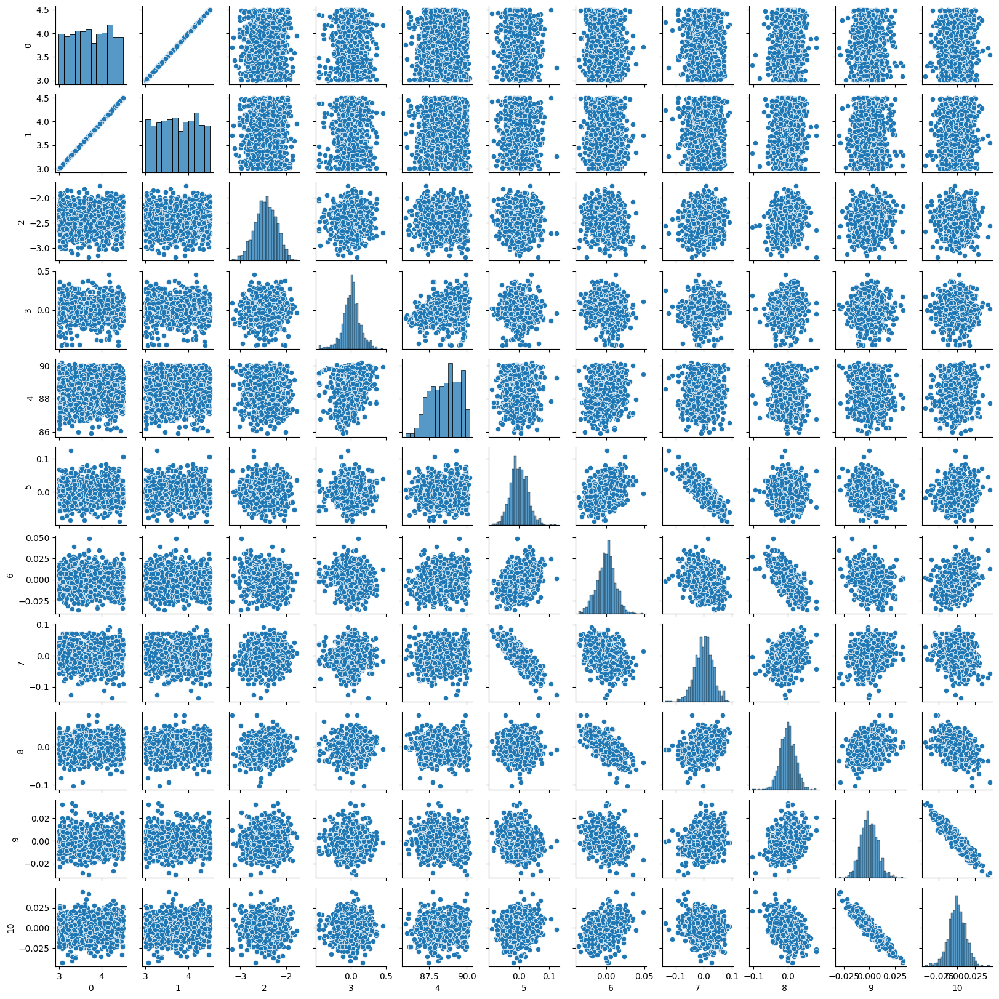

[0.43310435 0.43290495 0.23613284 0.12428566 0.94074628 0.02892511
 0.01180856 0.03194438 0.0224989  0.00855031 0.01177784]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.98760606e-05 -1.41452628e-05  2.97796989e-05
 -4.00599226e-05 -4.29259836e-07  5.12986901e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:58<00:00,  1.58s/it]


local
SpawnPoolWorker-11 11
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-9 9
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-12 12
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-10 10
CUDA_VISIBLE_DEVICES= 0
(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


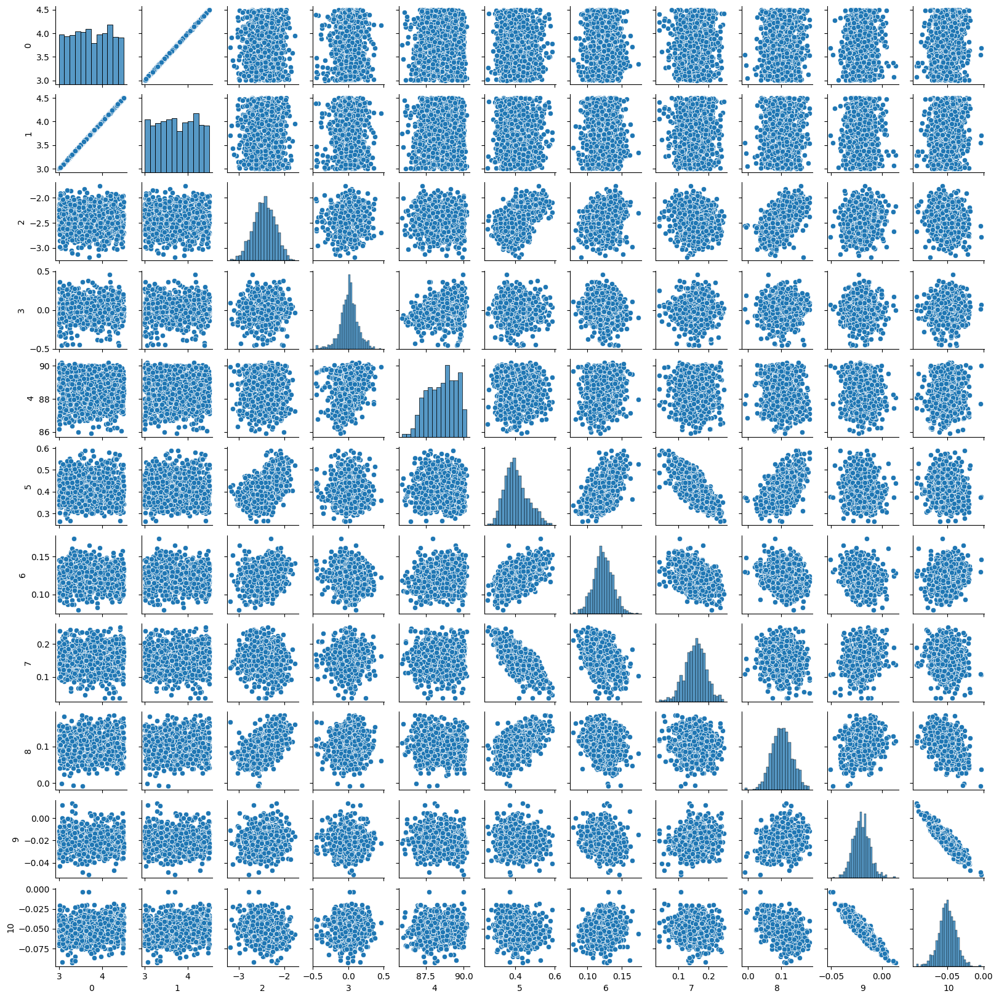

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


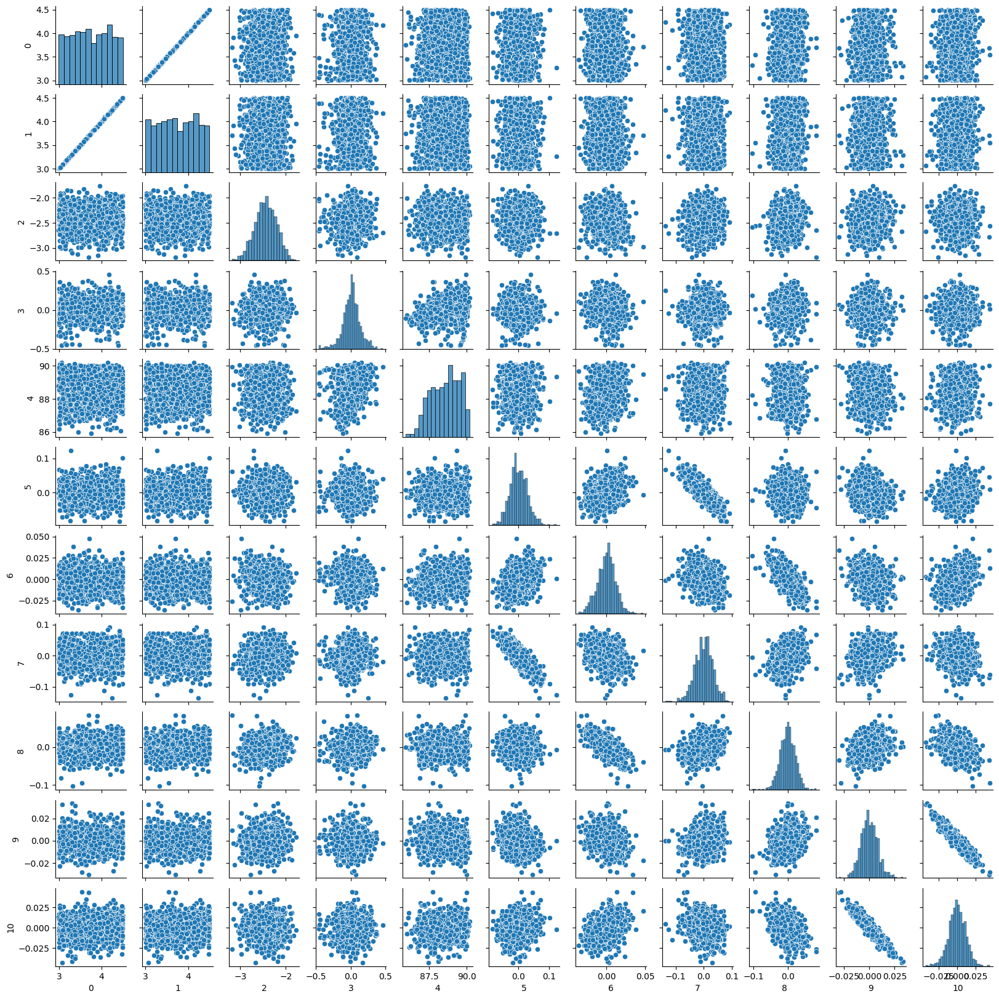

[0.43310596 0.43290465 0.23611648 0.12431903 0.94292919 0.02851753
 0.01165549 0.03192868 0.02233061 0.00849835 0.01172525]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95654511e-05 -1.38578136e-05  2.92002862e-05
 -4.06382021e-05 -4.02426242e-07  4.77005926e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:57<00:00,  1.58s/it]


local
SpawnPoolWorker-14 14
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-16 16
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-15 15
CUDA_VISIBLE_DEVICES= 0
(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


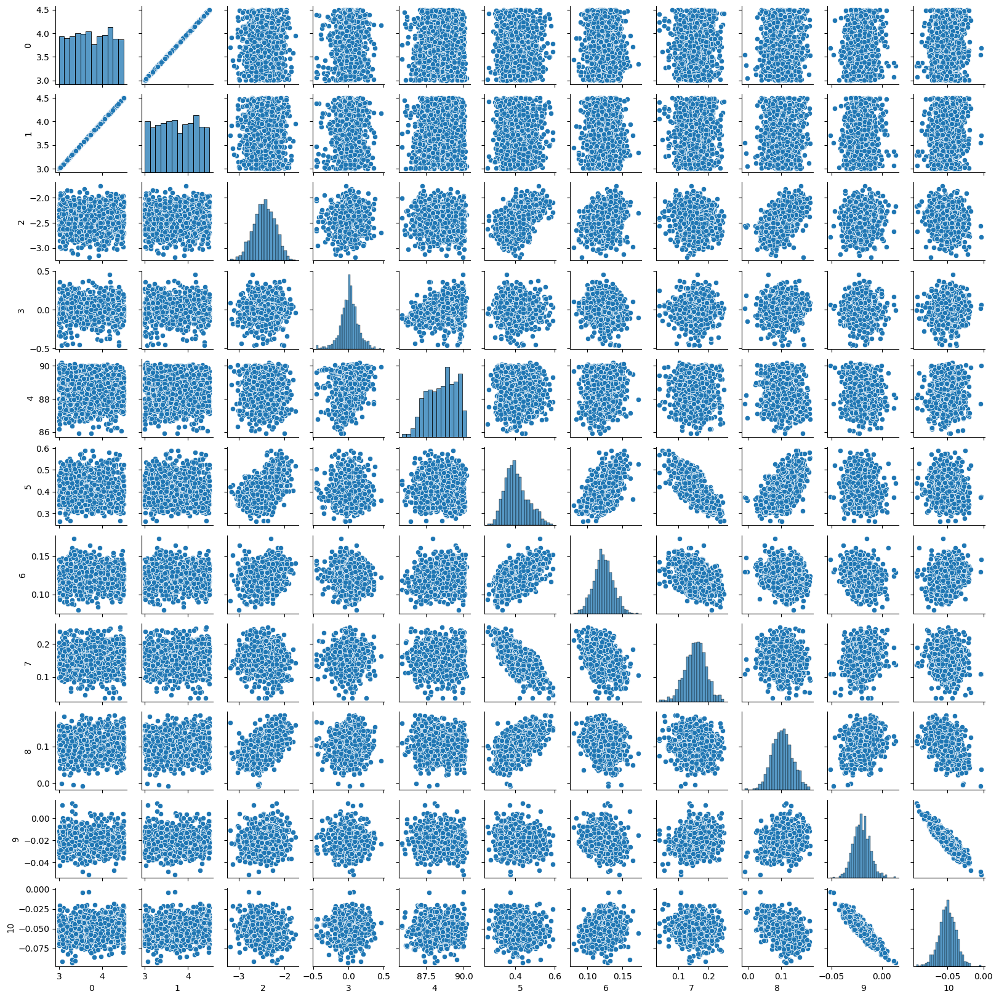

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


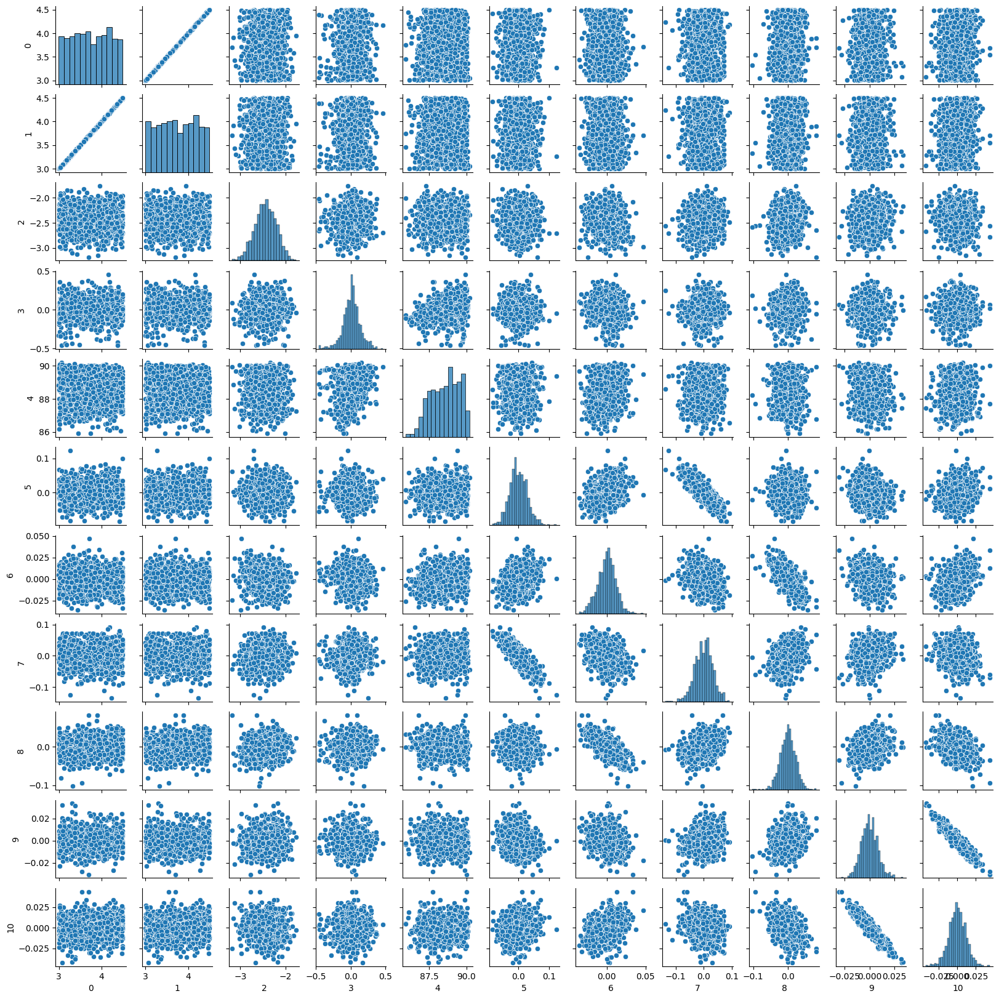

[0.43310425 0.43290412 0.23611176 0.12427396 0.94337232 0.02840646
 0.01153008 0.0319587  0.0222151  0.00849012 0.0117335 ]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.93802636e-05 -1.38038516e-05  2.89114033e-05
 -4.08209487e-05 -3.35022525e-07  4.50817234e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:23<00:00,  1.60s/it]


local
SpawnPoolWorker-19 19
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-20 20
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-18 18
CUDA_VISIBLE_DEVICES= 0
(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


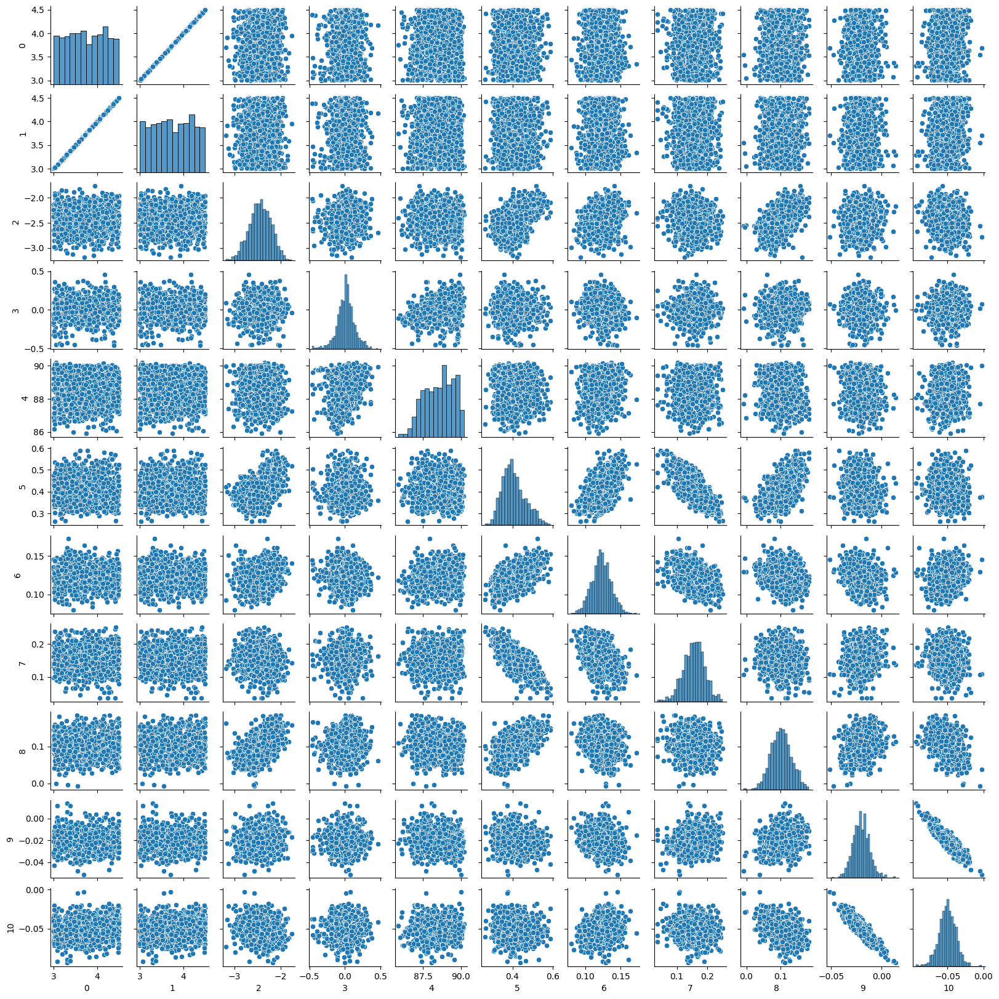

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


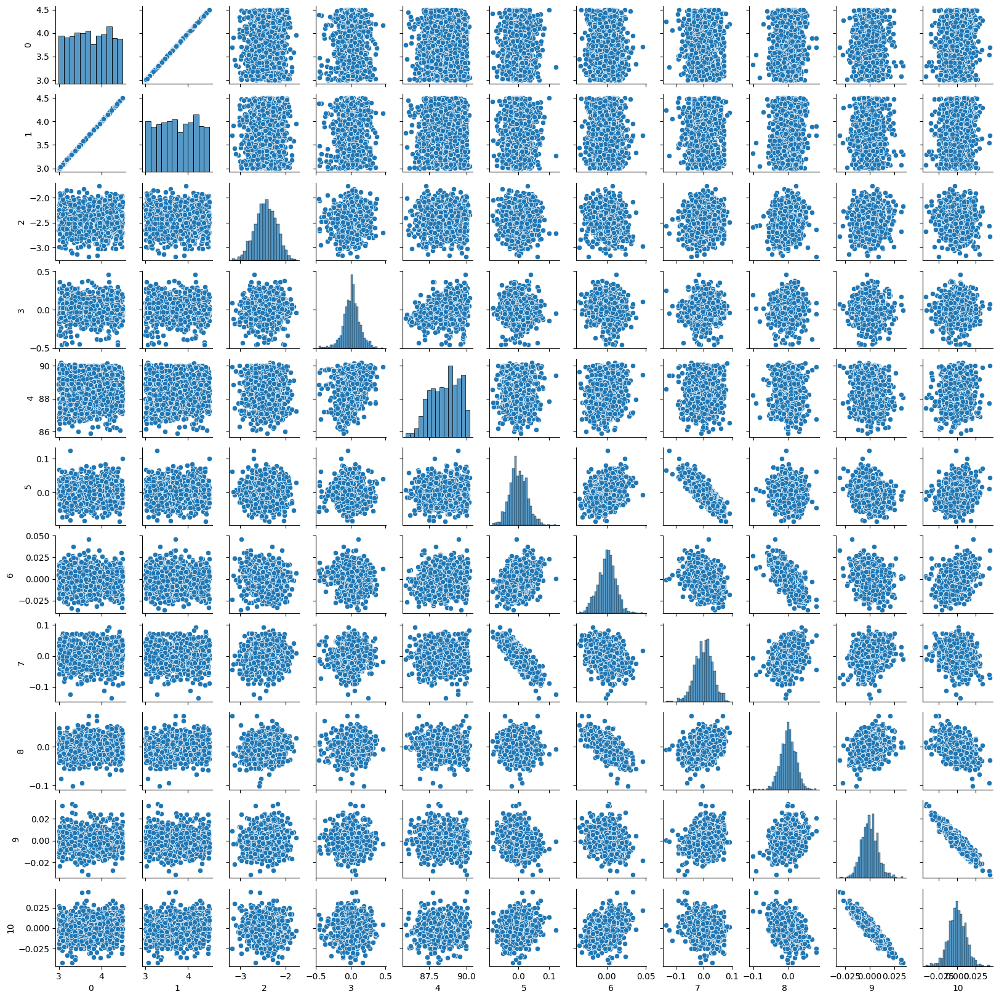

[0.43310453 0.43290365 0.23610406 0.1242154  0.94471524 0.0284047
 0.01143059 0.03197623 0.02210451 0.00848414 0.01175059]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.93507476e-05 -1.37442159e-05  2.88571831e-05
 -4.09320330e-05 -3.05200991e-07  4.41943462e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:09<00:00,  1.59s/it]


local
SpawnPoolWorker-21 21
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-22 22
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-23 23
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-24 24
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


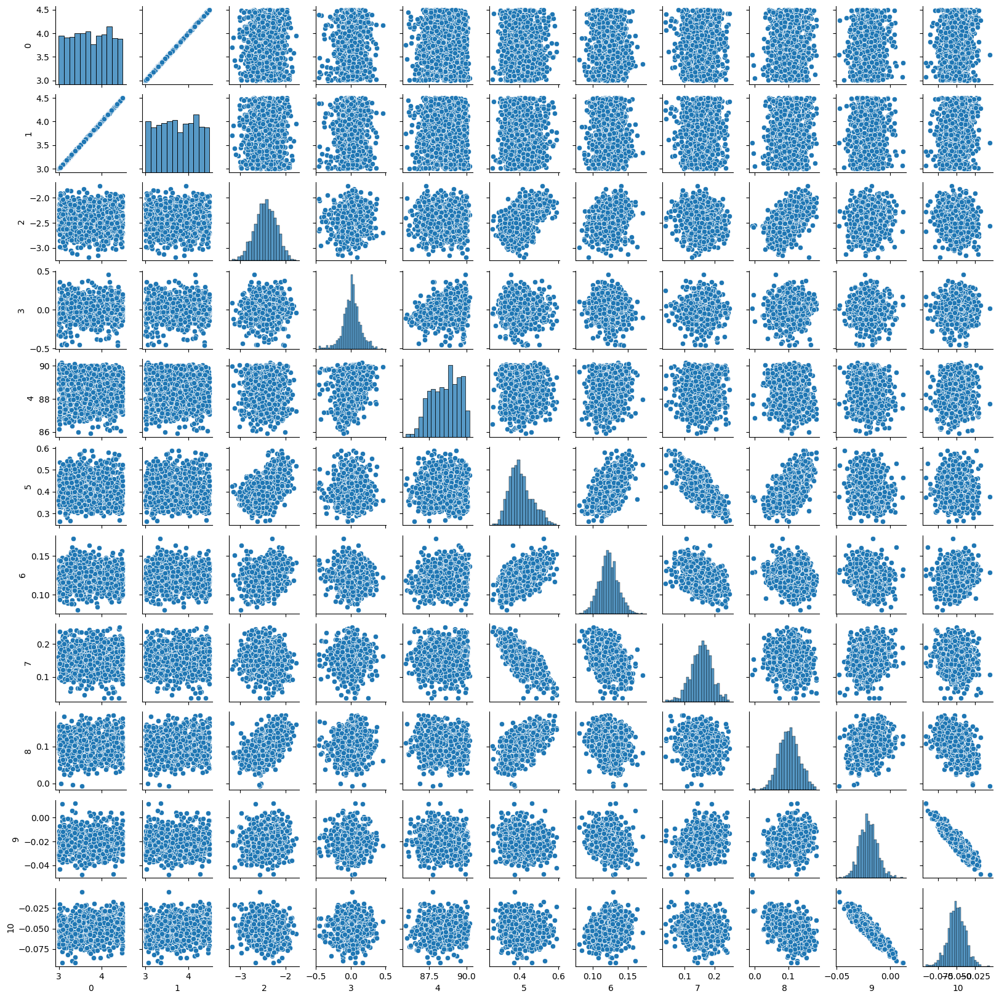

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


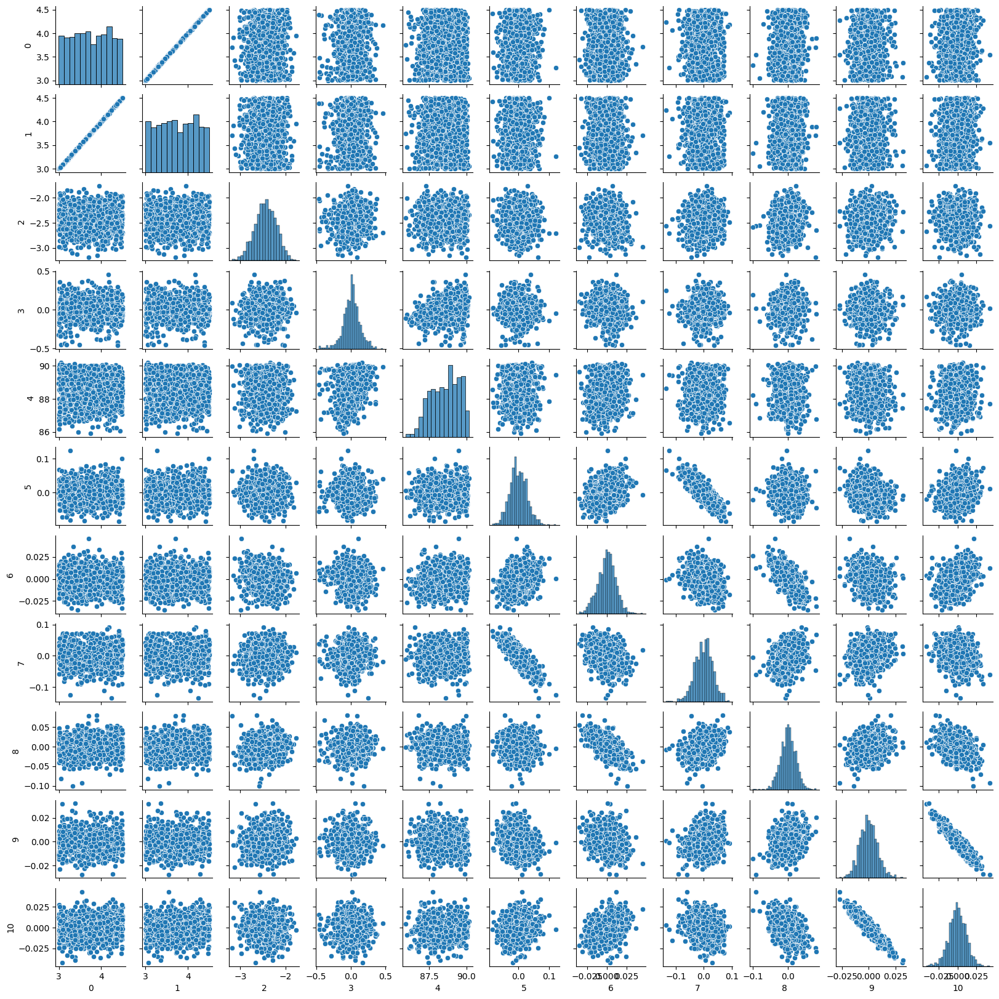

[0.43328944 0.43307723 0.23595765 0.12425265 0.944309   0.02838662
 0.0113034  0.03198986 0.02200231 0.00838104 0.01164017]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95263737e-05 -1.38074797e-05  2.91078812e-05
 -4.09102181e-05 -1.74712414e-07  4.22075010e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:58<00:00,  1.58s/it]


local
SpawnPoolWorker-27 27
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-25 25
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-28 28
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-26 26
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


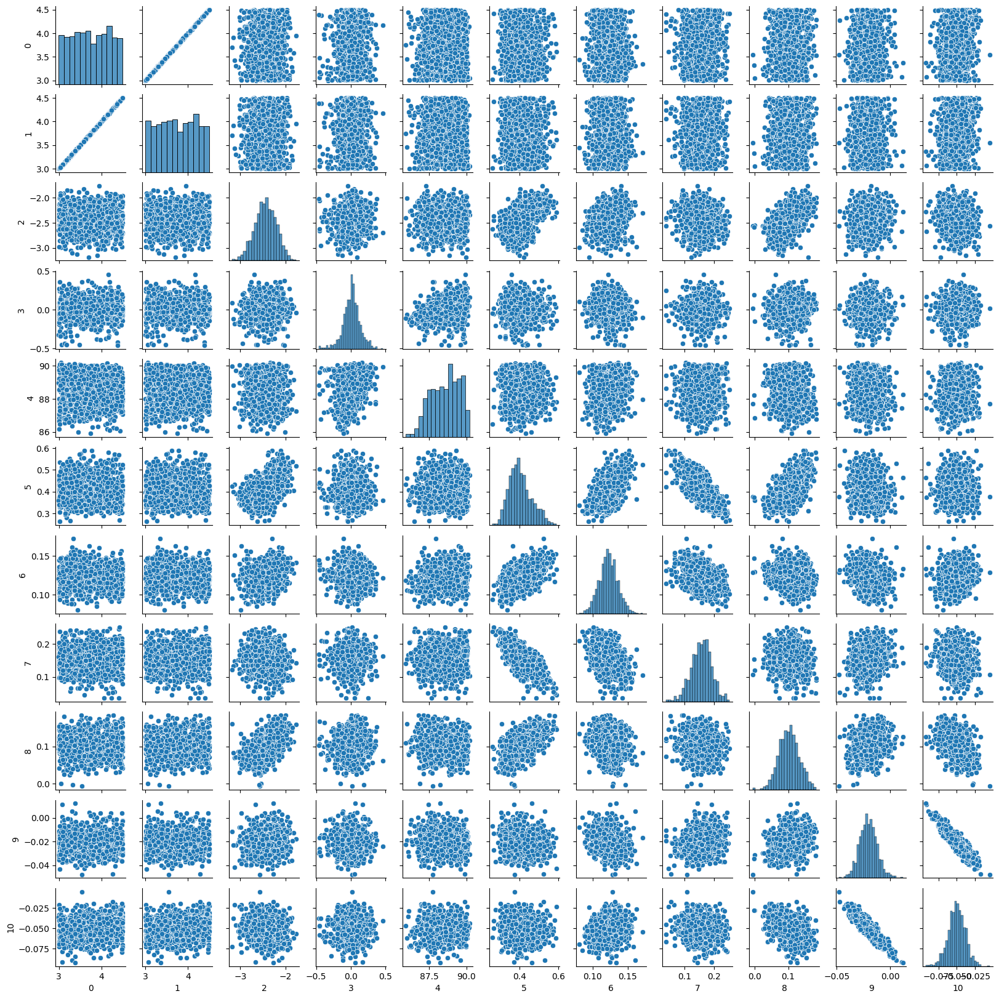

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


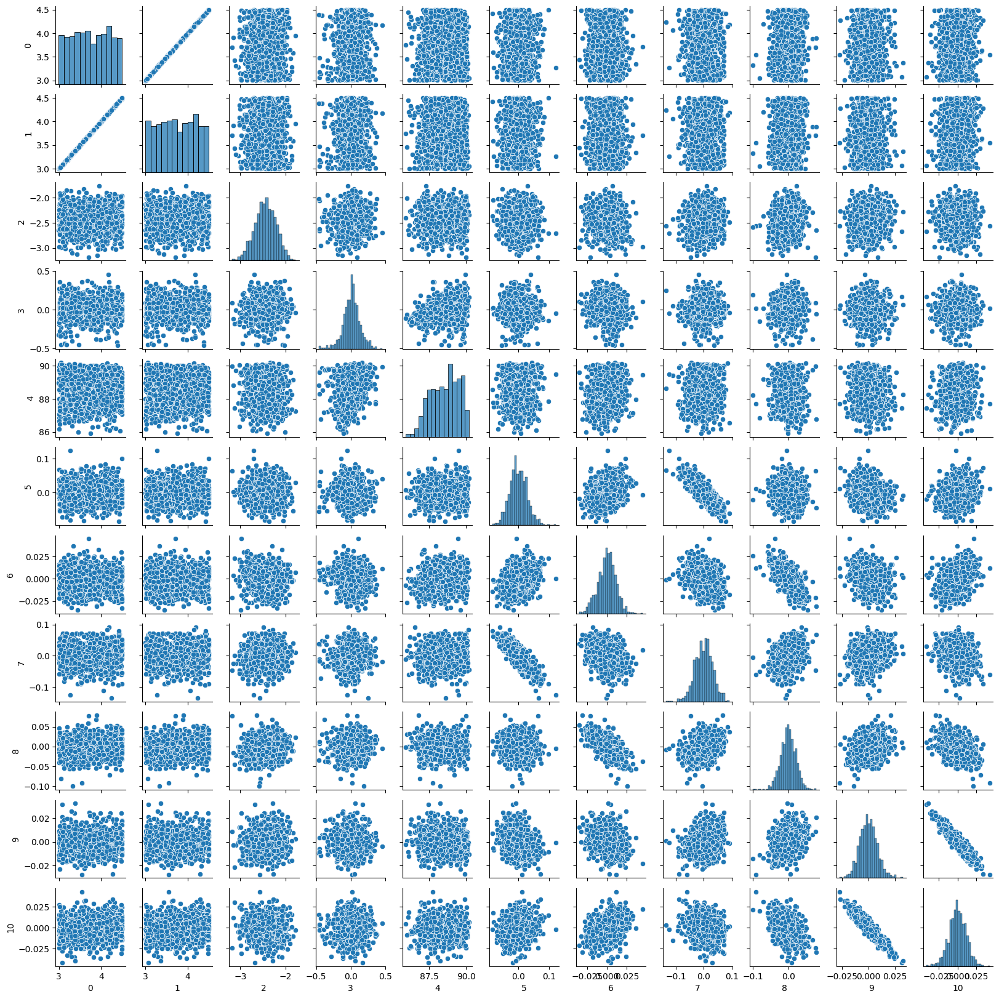

[0.4332905  0.43307668 0.23595643 0.12421815 0.94574812 0.02838324
 0.01119007 0.03198362 0.02189856 0.00833822 0.0116079 ]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95502834e-05 -1.38454036e-05  2.91436097e-05
 -4.08776968e-05 -8.67843499e-08  4.07619471e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:47<00:00,  1.57s/it]


local
SpawnPoolWorker-29 29
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-31 31
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-30 30
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-32 32
CUDA_VISIBLE_DEVICES= 0
(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


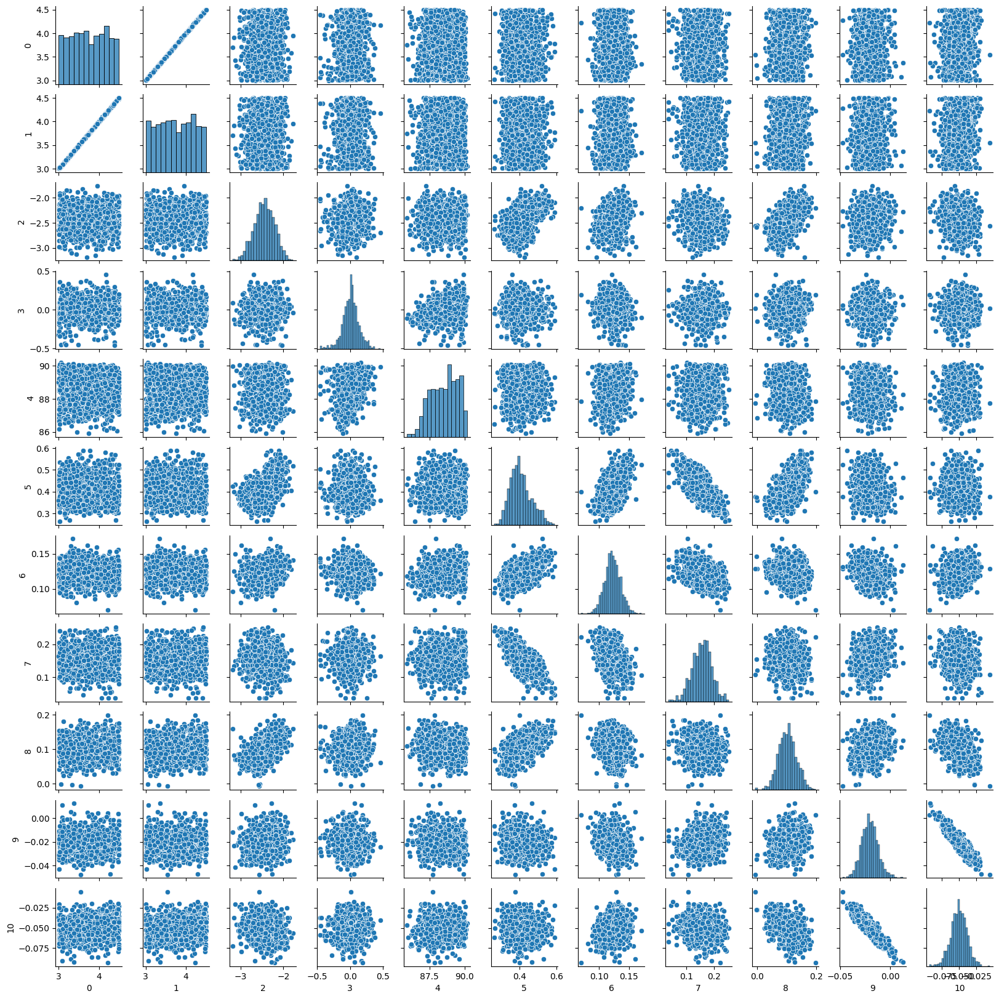

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


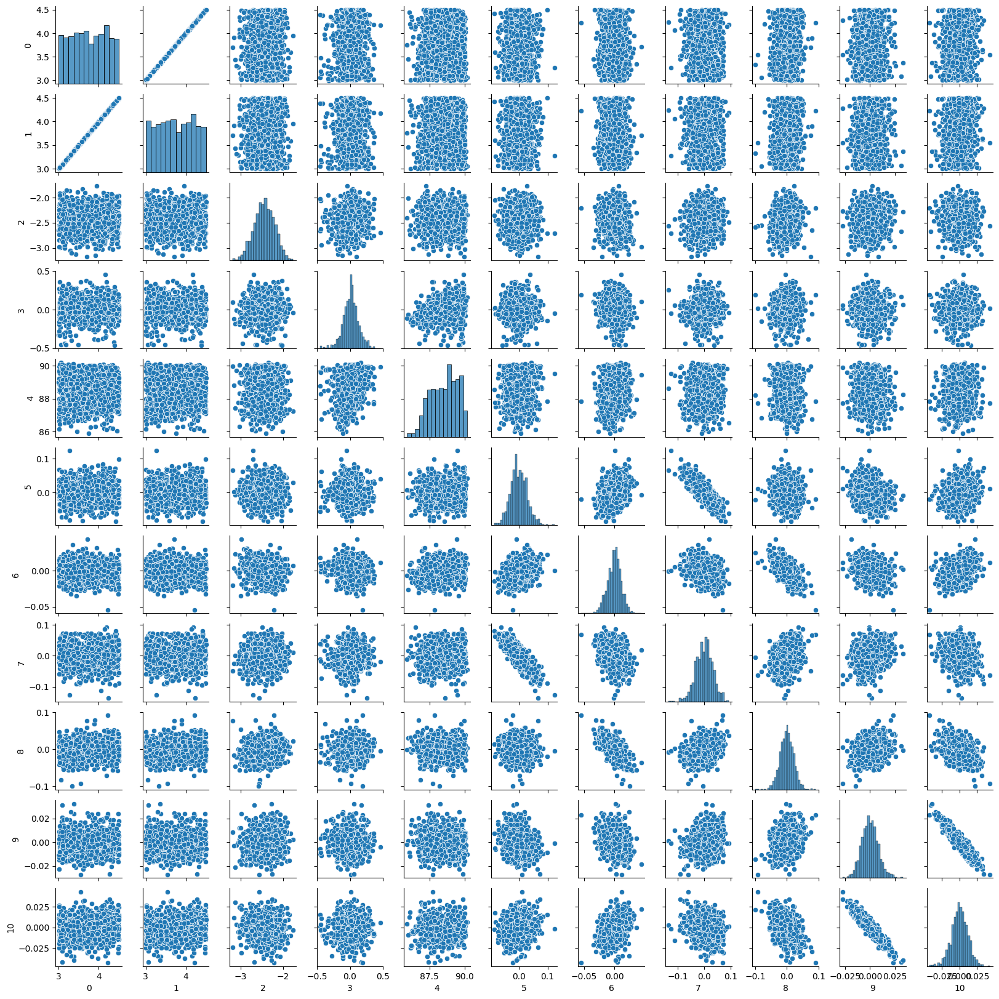

[0.43332983 0.43311367 0.23595296 0.12423129 0.9452479  0.02839008
 0.01119667 0.03203453 0.02194983 0.00834389 0.01167279]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95869519e-05 -1.38368134e-05  2.91815702e-05
 -4.08986700e-05 -6.27206380e-08  4.05006512e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:57<00:00,  1.58s/it]


local
SpawnPoolWorker-34 34
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-35 35
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-36 36
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-33 33
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


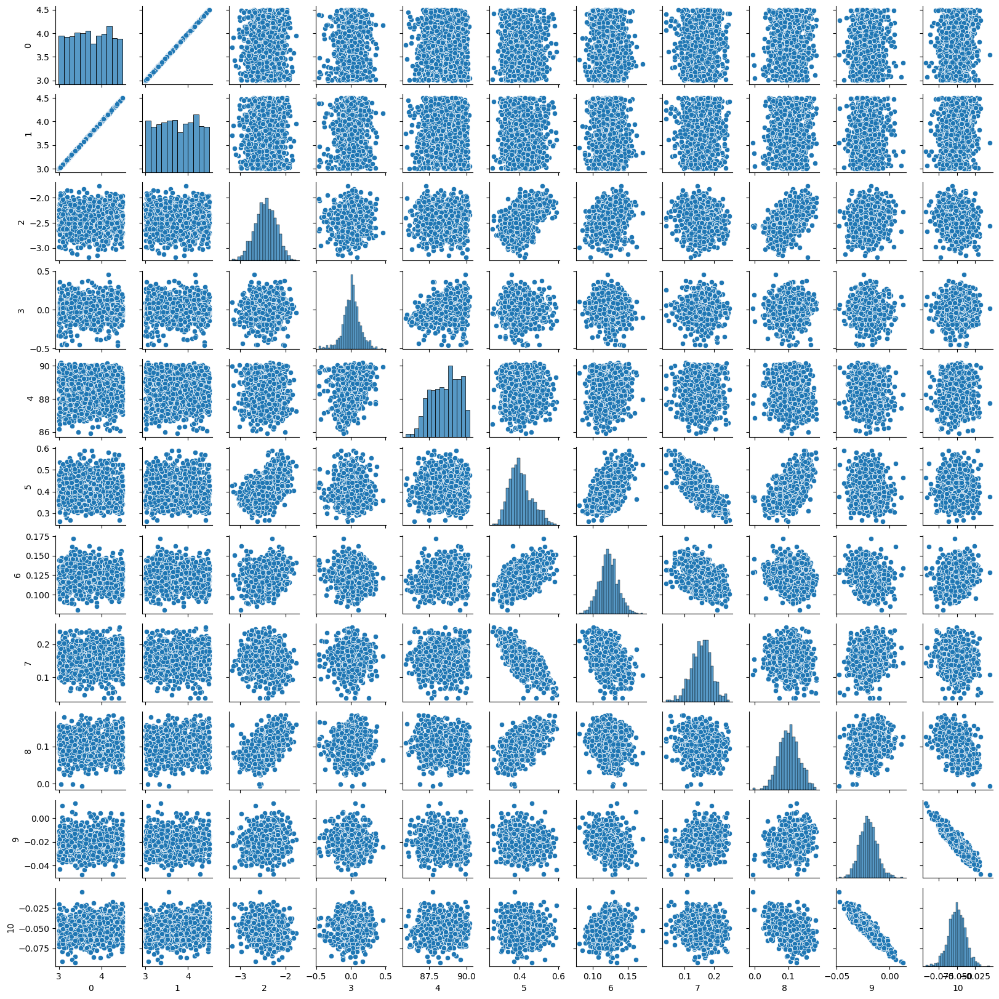

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


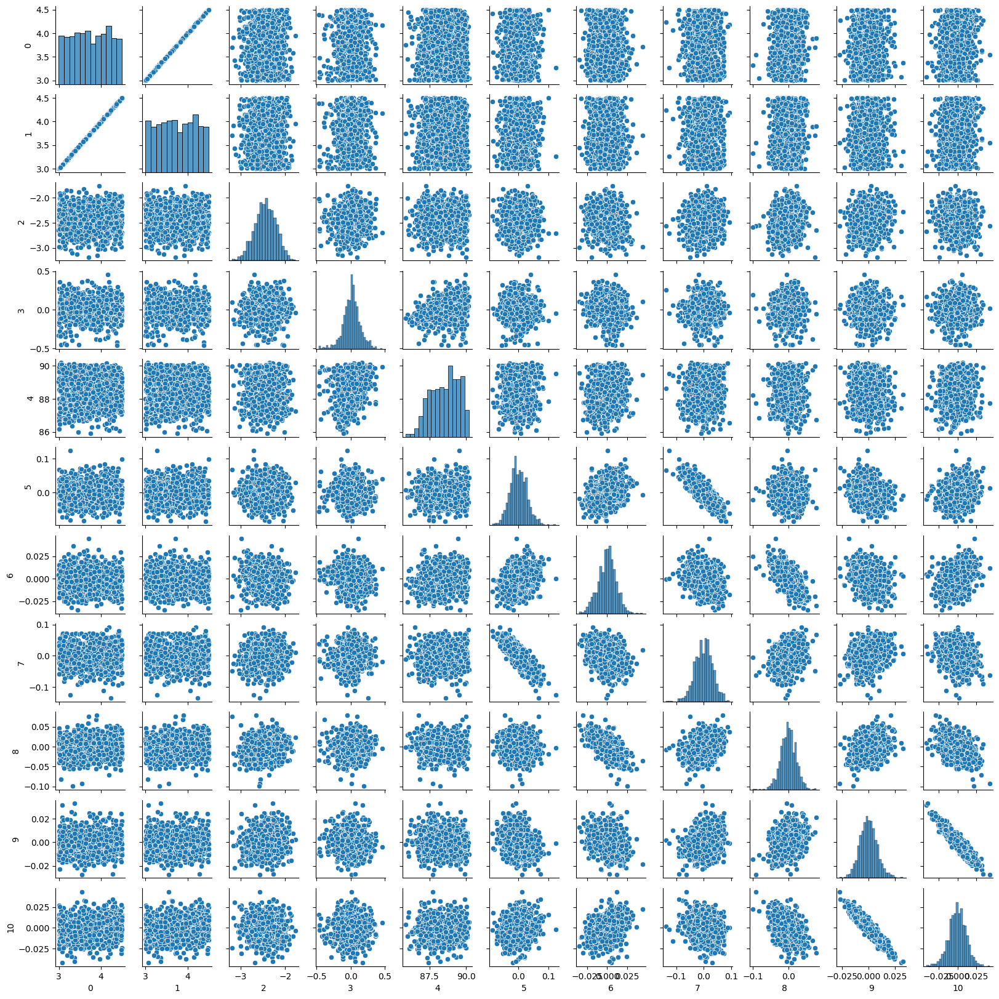

[0.4332933  0.4330767  0.2359469  0.12412728 0.94645047 0.02839754
 0.01107722 0.03203645 0.02177453 0.00832307 0.01165073]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95308664e-05 -1.37560224e-05  2.91674771e-05
 -4.09765110e-05 -1.23332144e-07  4.15767369e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:11<00:00,  1.59s/it]


local
SpawnPoolWorker-39 39
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-40 40
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-38 38
CUDA_VISIBLE_DEVICES= 0
(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


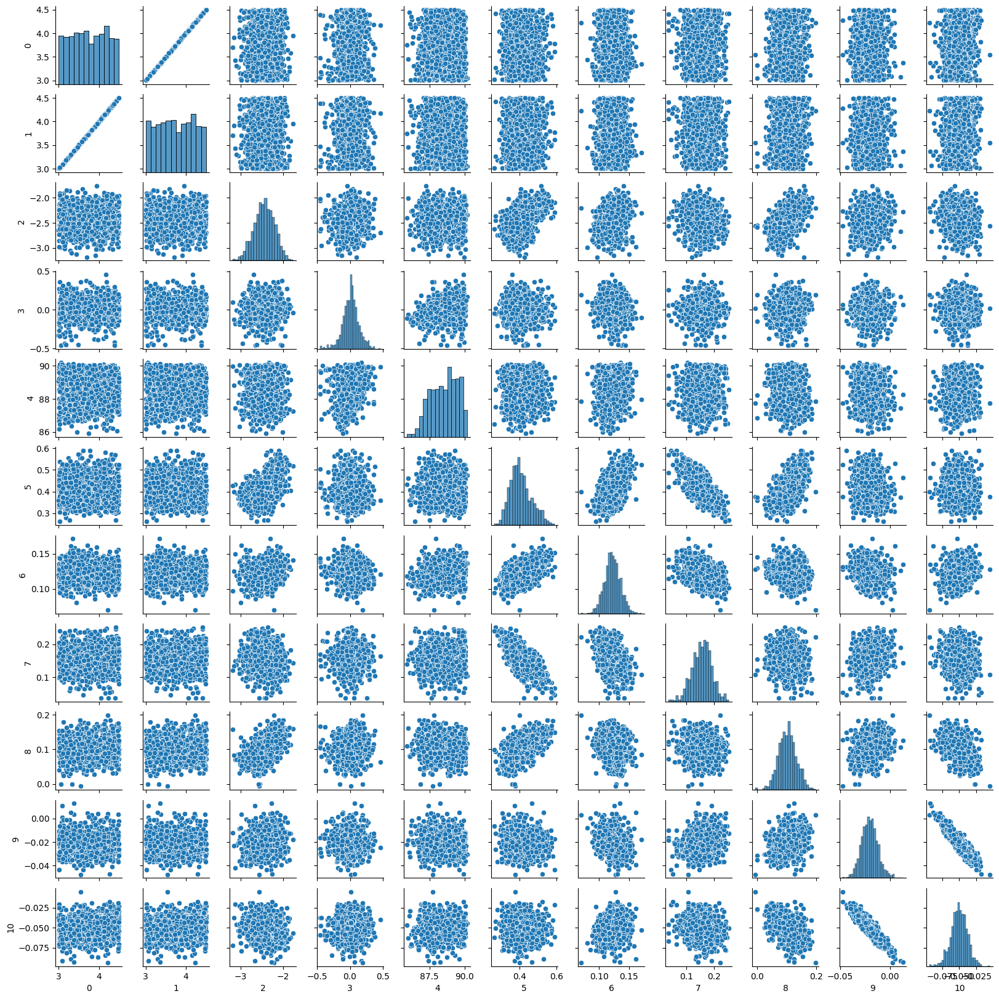

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


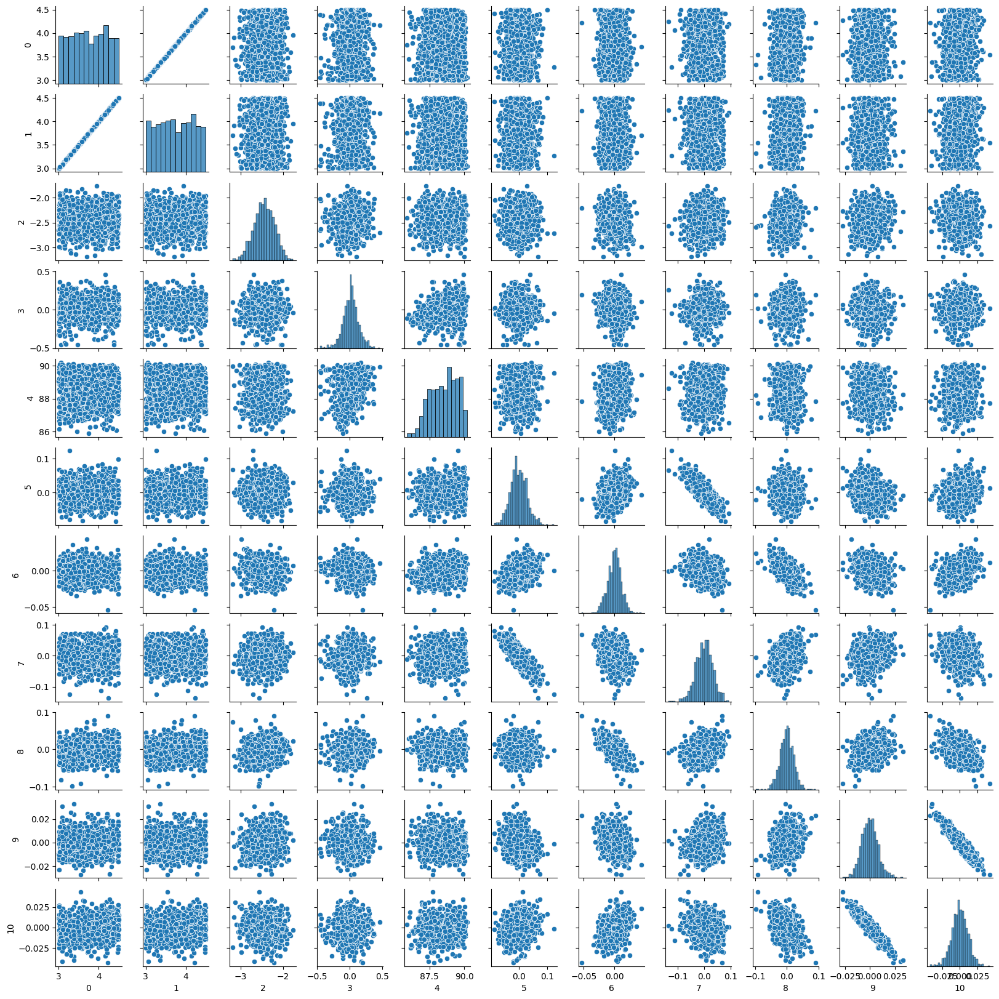

[0.4333301  0.43311325 0.23594261 0.12412633 0.945596   0.02842418
 0.01108577 0.03206044 0.02178149 0.00834737 0.01174415]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95587938e-05 -1.37846012e-05  2.91357352e-05
 -4.09602136e-05 -1.07632521e-07  4.15801915e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:06<00:00,  1.59s/it]


local
SpawnPoolWorker-43 43
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-42 42
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-44 44
CUDA_VISIBLE_DEVICES= 0
(1082, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


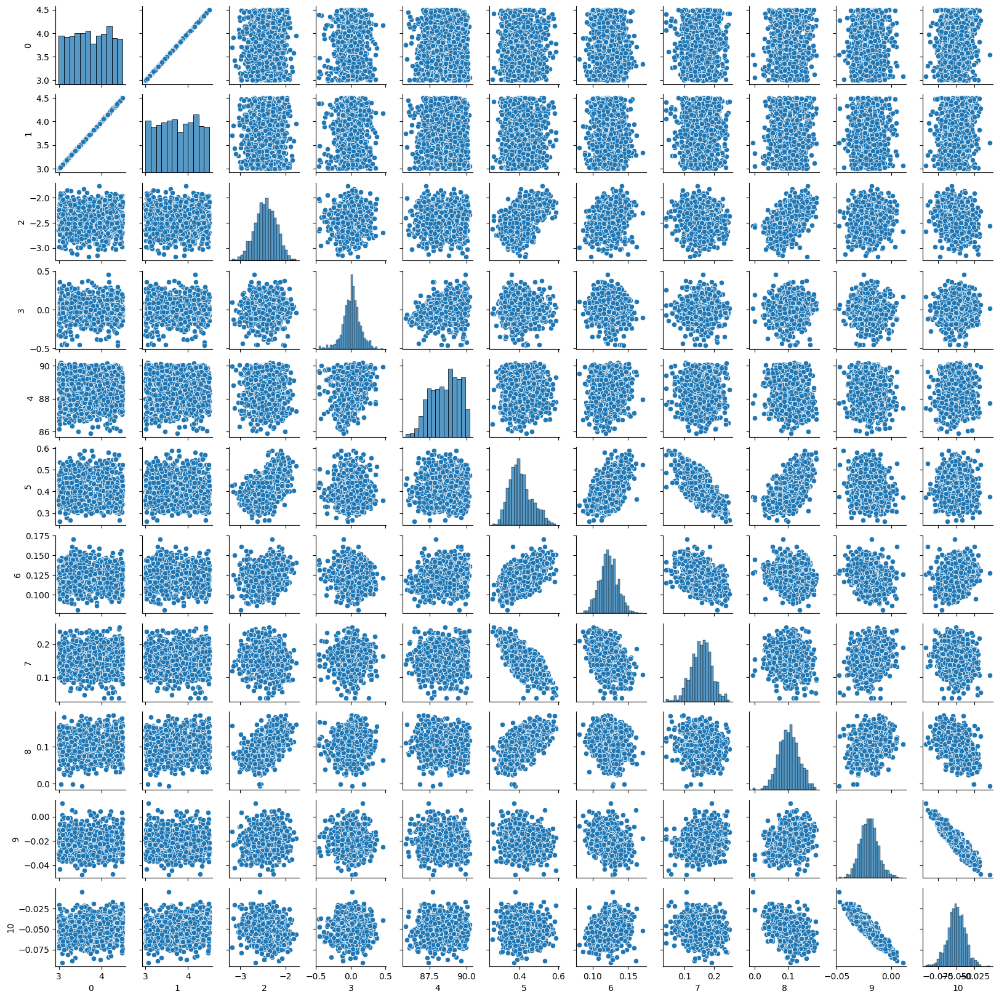

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


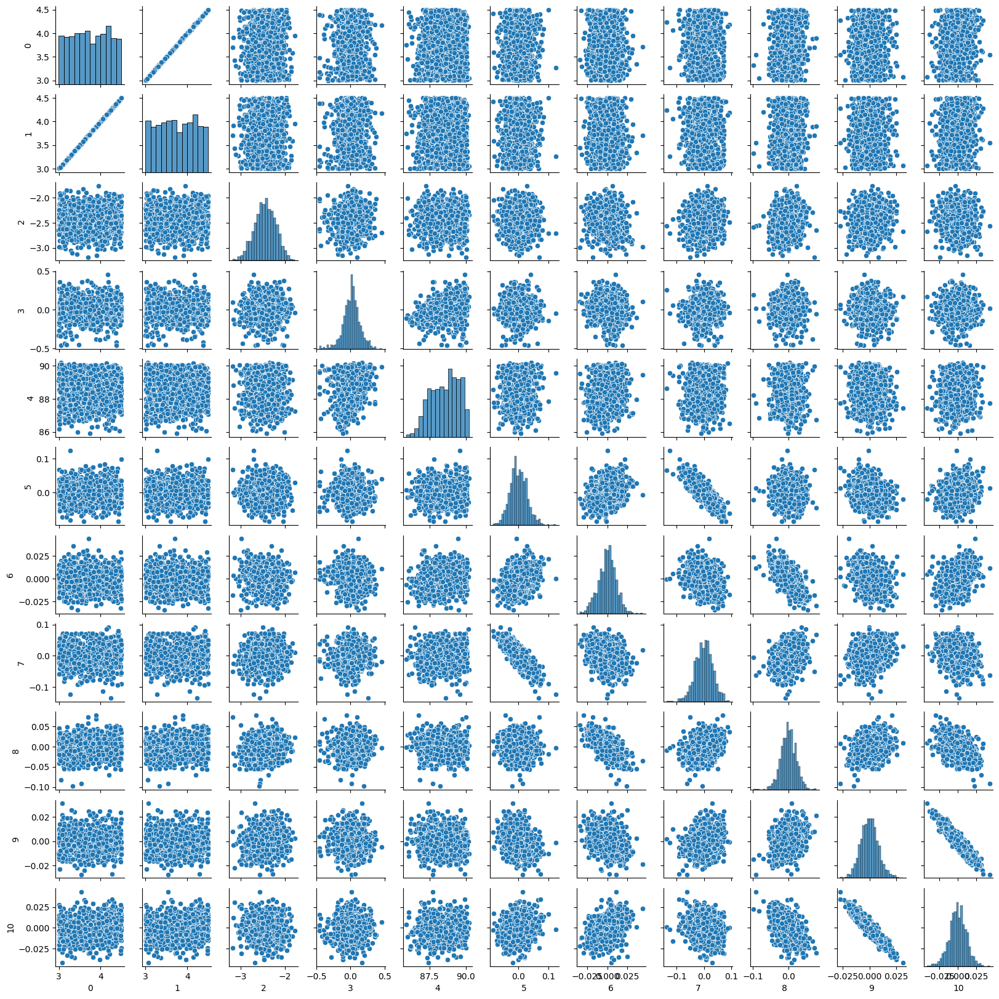

[0.43334031 0.43311594 0.23600048 0.12409967 0.9471451  0.02844227
 0.01096043 0.03205053 0.02160311 0.00828335 0.011691  ]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95690848e-05 -1.38383969e-05  2.91240299e-05
 -4.08824569e-05 -1.56441570e-09  4.02285956e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:55<00:00,  1.58s/it]


local
SpawnPoolWorker-48 48
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-45 45
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-47 47
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-46 46
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


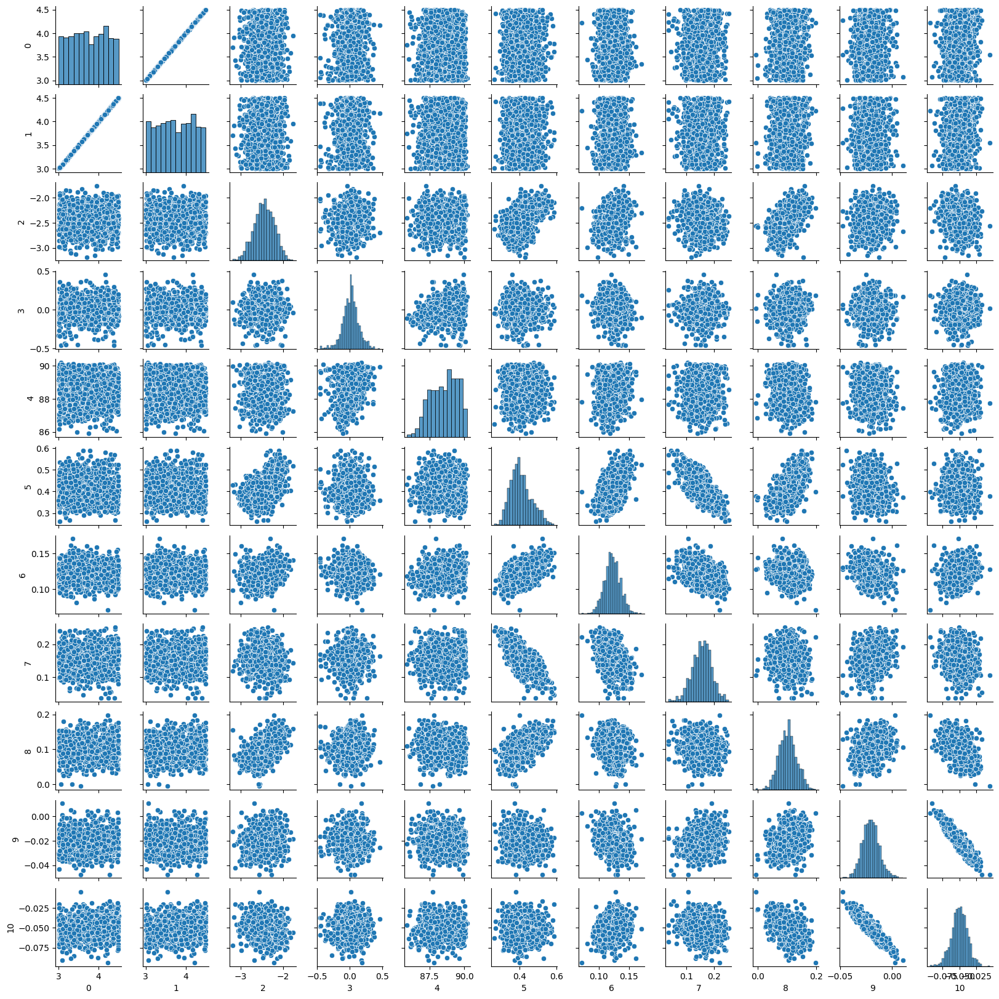

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


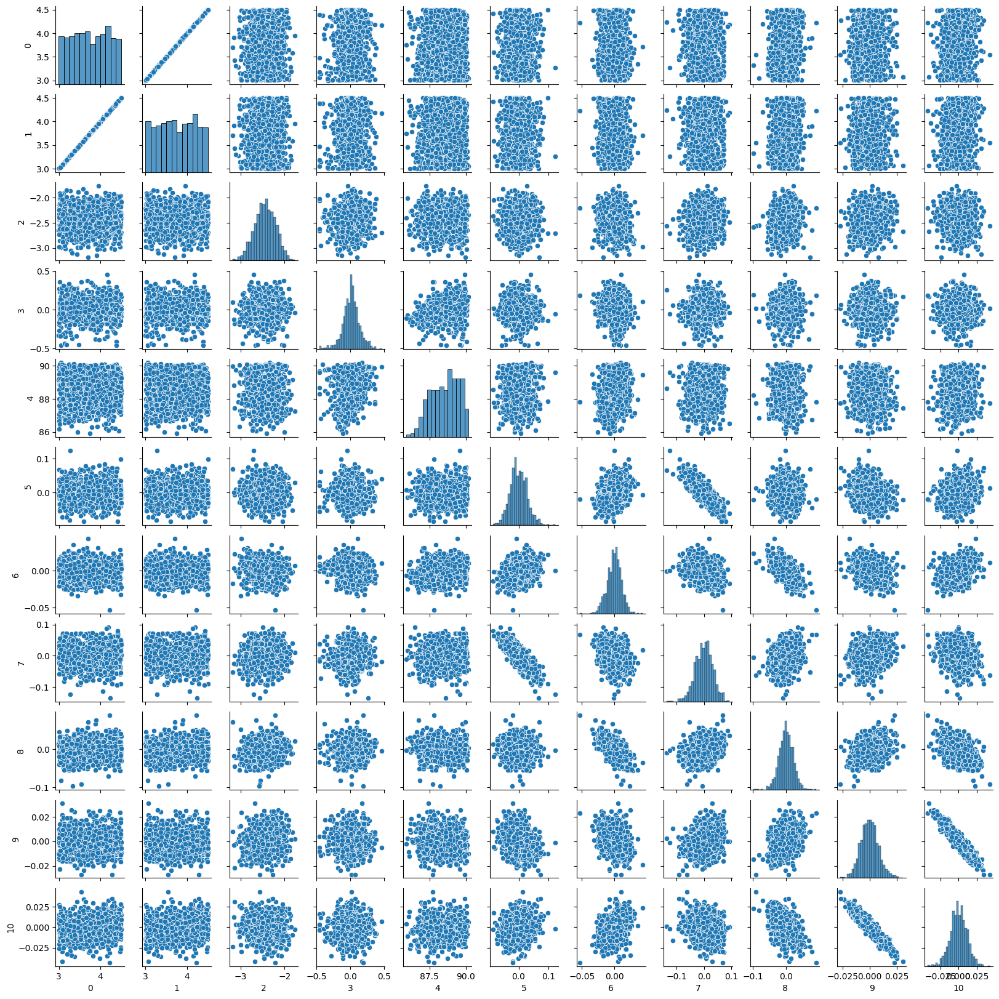

[0.43337905 0.43315232 0.23599283 0.12405125 0.94667759 0.028439
 0.01096479 0.03207077 0.02160391 0.00830252 0.01178125]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.95541176e-05 -1.38103779e-05  2.90776171e-05
 -4.09313450e-05  6.20433481e-09  4.01096286e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:06<00:00,  1.59s/it]


local
SpawnPoolWorker-51 51
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-50 50
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-49 49
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-52 52
CUDA_VISIBLE_DEVICES= 0
(1082, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


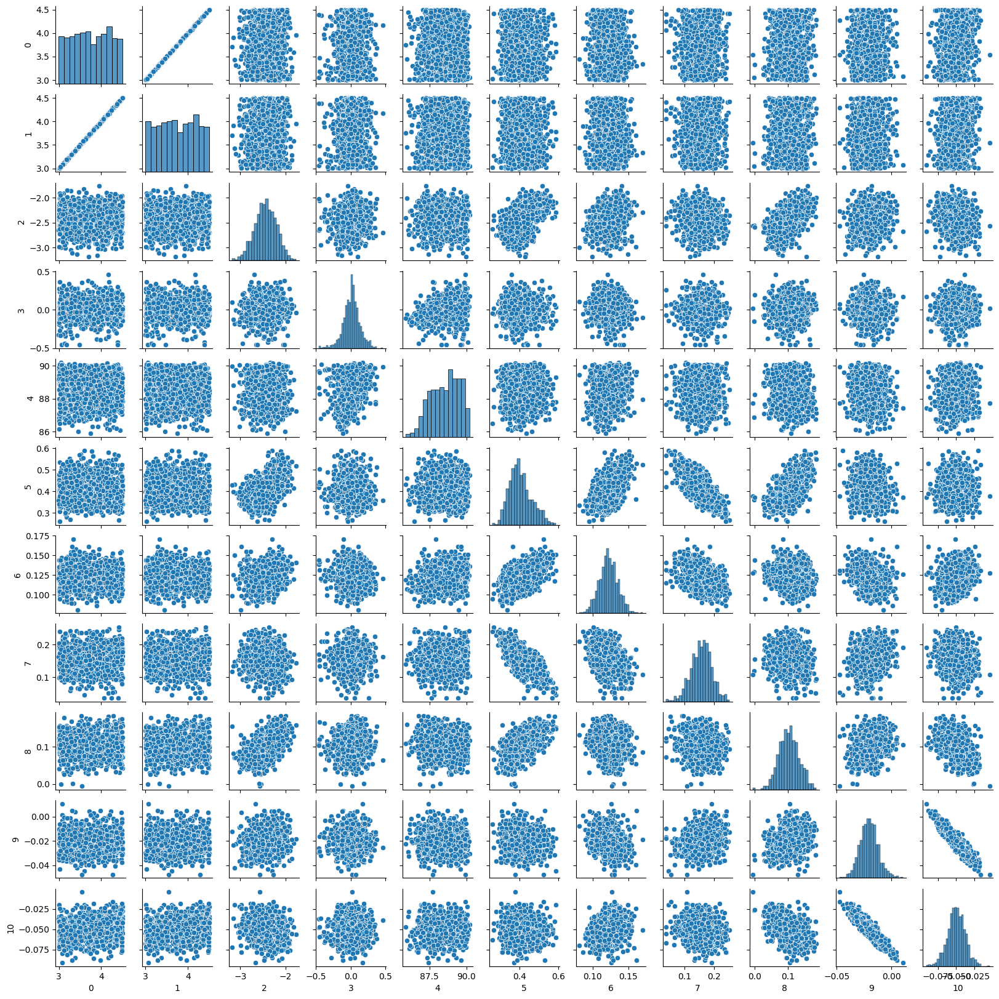

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


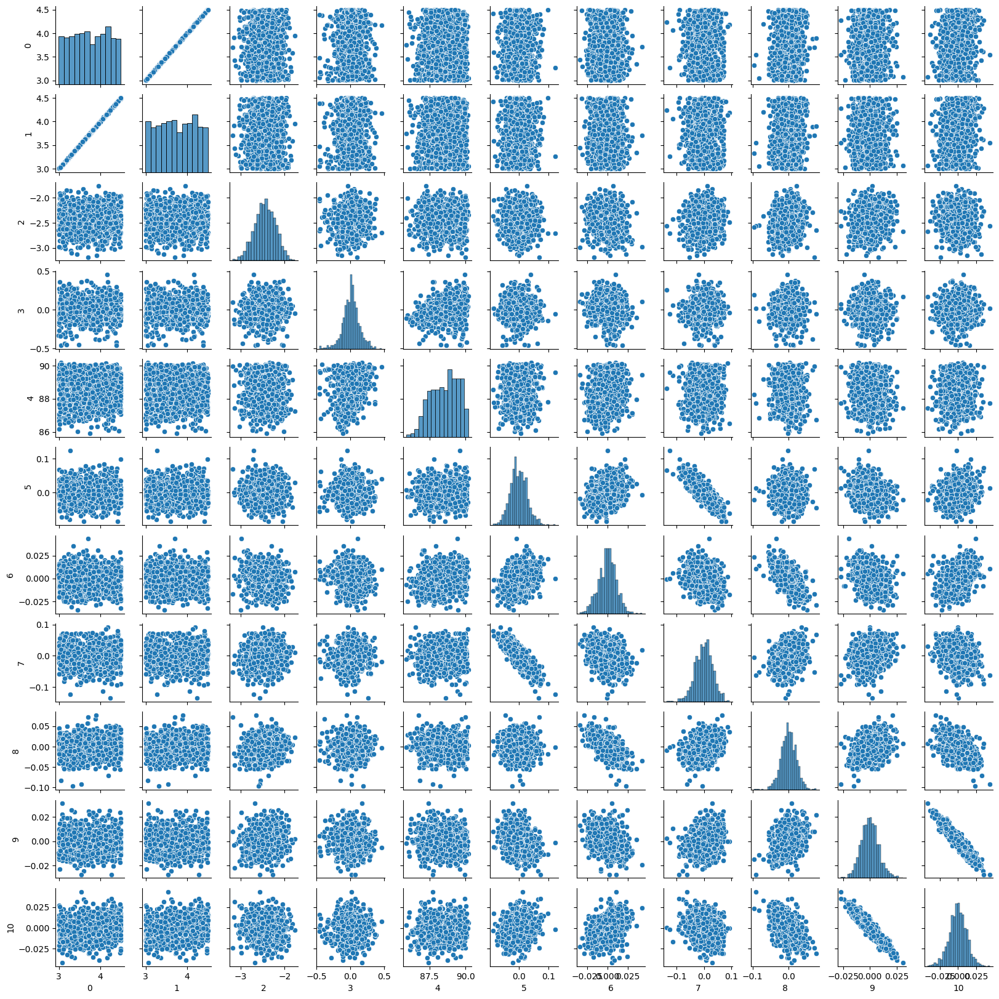

[0.43334438 0.43311568 0.23599265 0.12404267 0.94793246 0.02843531
 0.0108444  0.03206841 0.02142261 0.00828053 0.01176153]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.94907082e-05 -1.36832881e-05  2.90751661e-05
 -4.10746506e-05 -2.43519537e-08  4.06529549e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:56<00:00,  1.58s/it]


local
SpawnPoolWorker-54 54
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-53 53
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-56 56
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-55 55
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


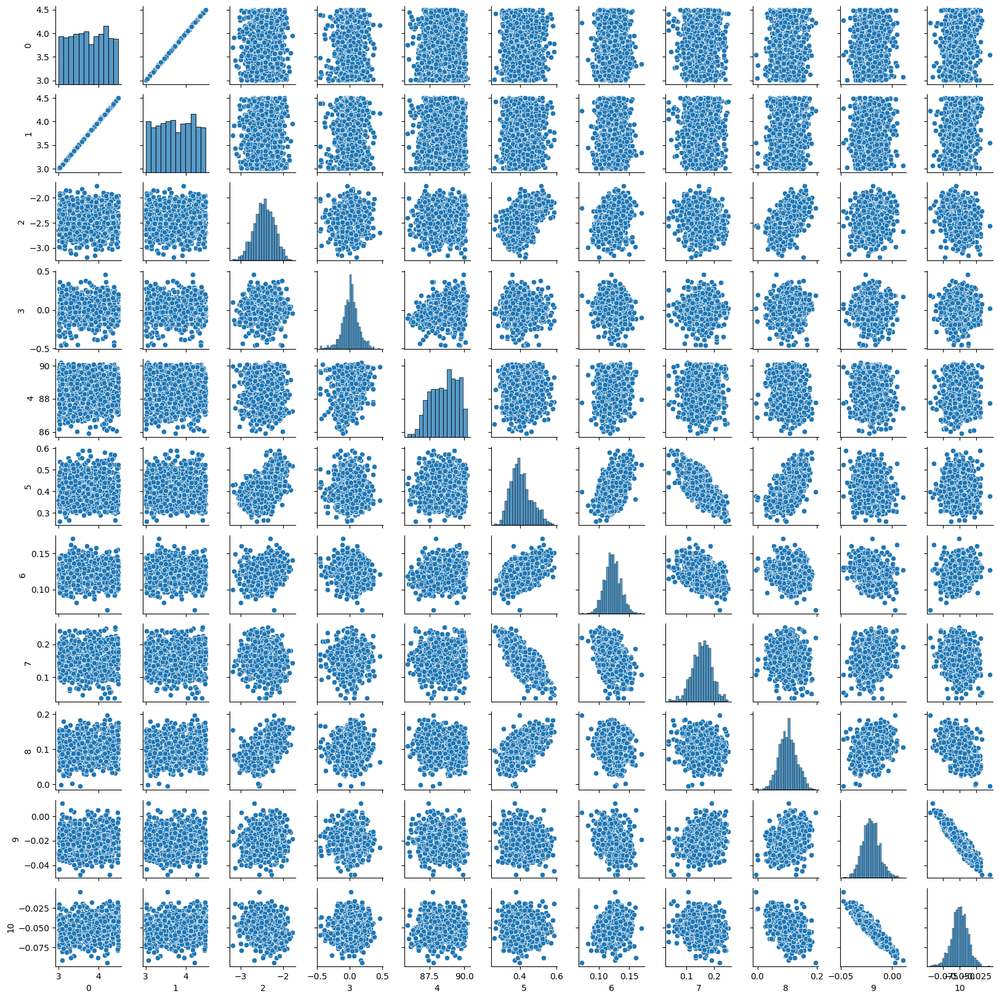

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


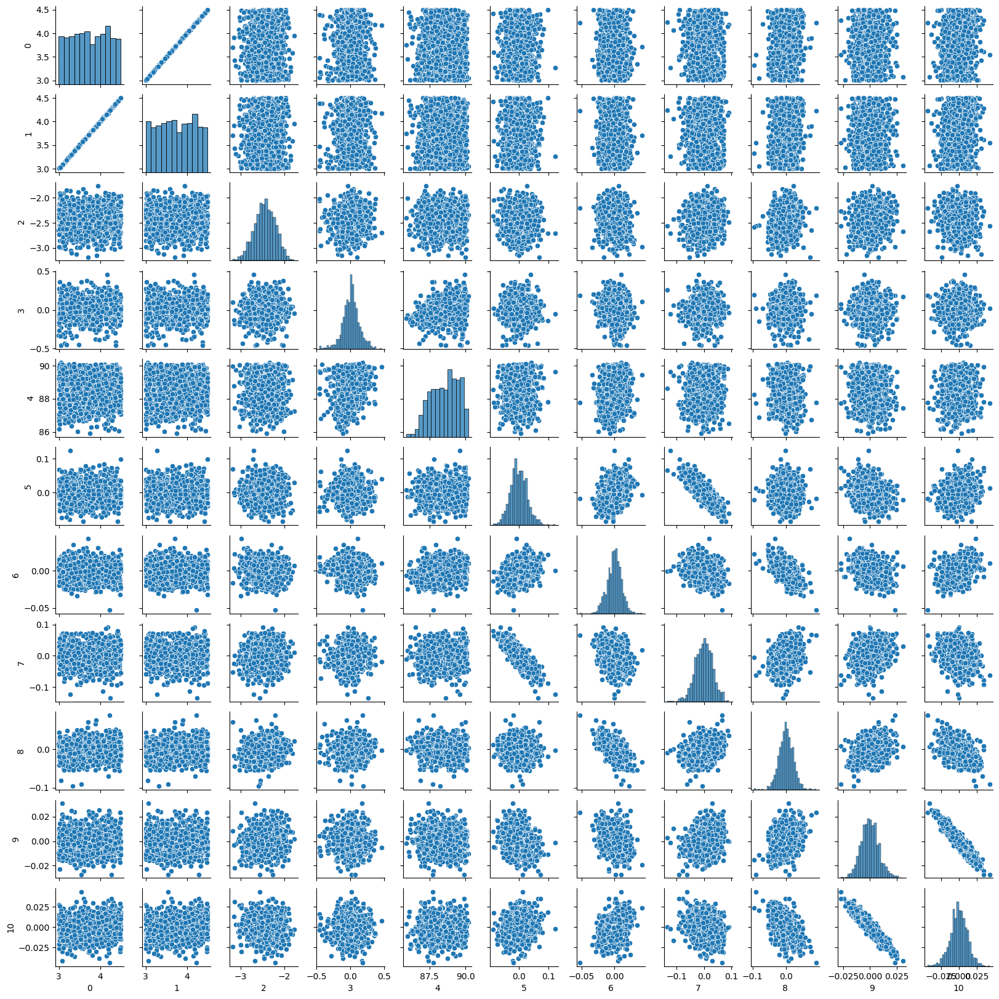

[0.4333813  0.43315196 0.23599568 0.12404549 0.94760711 0.0285007
 0.01086977 0.03215004 0.02146218 0.008327   0.01187548]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.94063186e-05 -1.36849683e-05  2.89526442e-05
 -4.11145512e-05 -4.43761816e-08  4.05412142e-06]


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:56<00:00,  1.58s/it]


local
SpawnPoolWorker-58 58
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-57 57
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-60 60
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-59 59
CUDA_VISIBLE_DEVICES= 0
(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


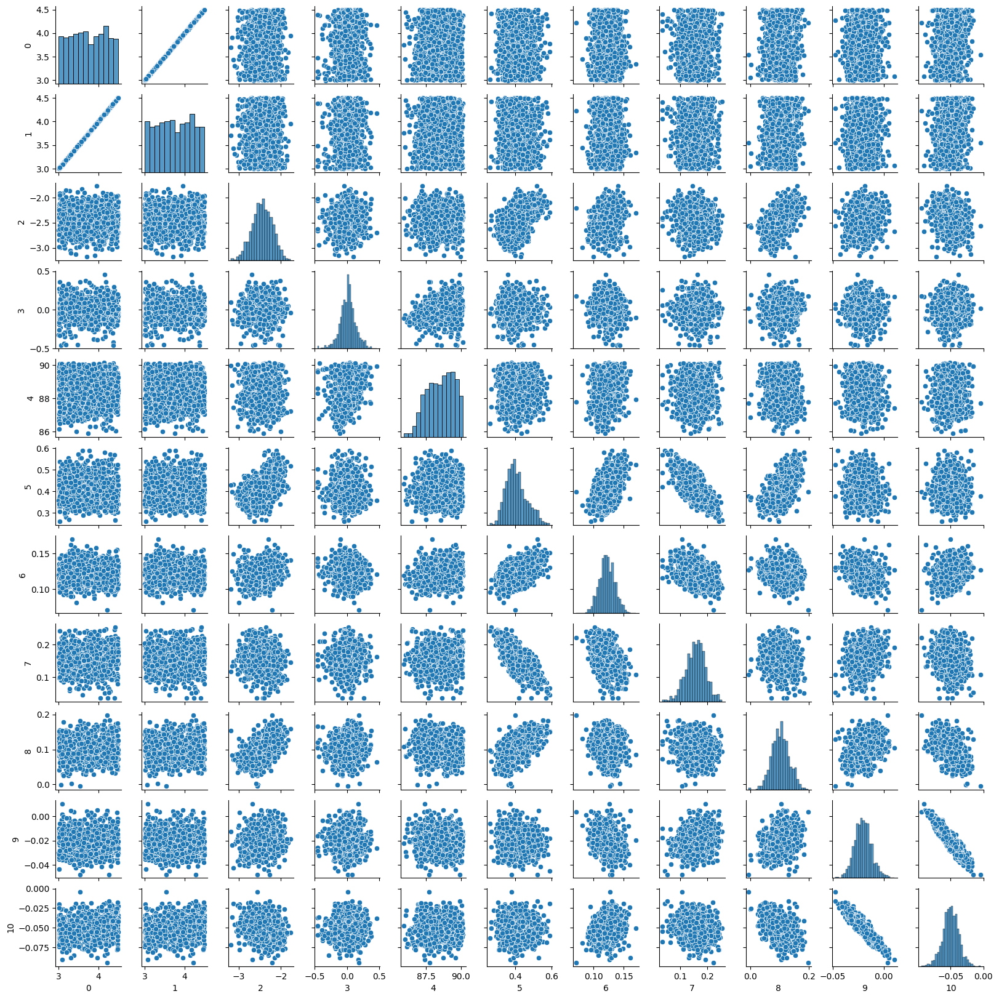

/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


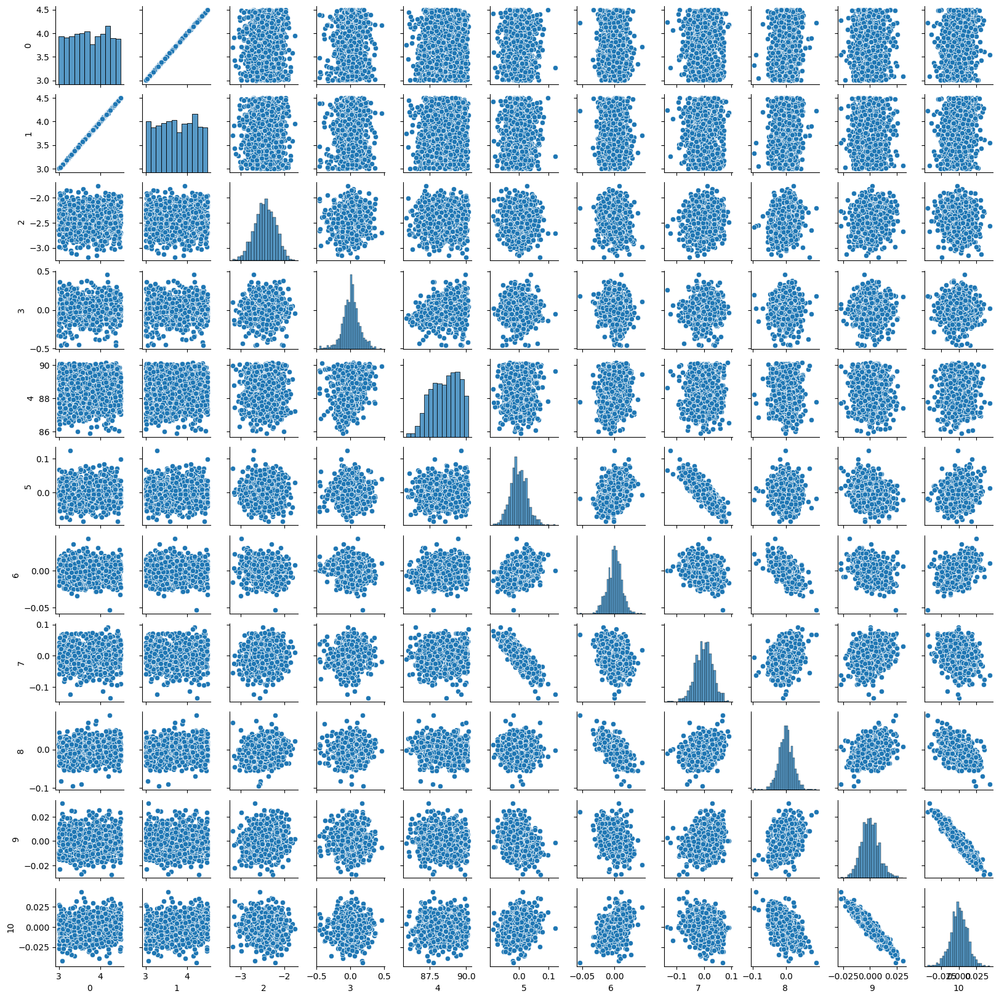

[0.43338002 0.43315203 0.23598799 0.12406191 0.94807285 0.02849006
 0.01086678 0.03217492 0.02143507 0.00833835 0.01193989]
[ 0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
  0.00000000e+00 -9.93299915e-05 -1.35955605e-05  2.88725036e-05
 -4.12500653e-05 -1.19734627e-07  4.16045164e-06]


In [8]:
kgs.sanity_checks_active = False
for ii in range(15):
    if ii==0:
        data = copy.deepcopy(train_data2)
    data = model.infer(data)
    transit_parameters = []
    for d in data:
        d.diagnostics['starting_par'] = d.diagnostics['par_mean']
        modelr.model.results['model_samples'].m['signal'].set_parameters(d.diagnostics['par_samples'])
        transit_parameters.append(modelr.model.results['model_samples'].m['signal'].m['main'].m['transit'].get_parameters()[:,0])
    transit_parameters = np.array(transit_parameters)
    
    transit_parameters, inds_left = remove_outlier(transit_parameters,4)
    print(transit_parameters.shape)

    #plt.figure()
    #plt.imshow(np.corrcoef(transit_parameters.T))
    #plt.colorbar()
    sns.pairplot(pd.DataFrame(transit_parameters), diag_kind="hist", corner=False, height=1.5)
    plt.pause(0.0001)
    
    # Mean
    mu_est = np.mean(transit_parameters,0)
    TS_slopes = 0*mu_est
    X = np.stack(( np.array([d.transit_params.Ts for d in data])[inds_left], np.ones((transit_parameters.shape[0]))))
    for i_param in [5,6,7,8,9,10]:
        y = transit_parameters[:,i_param]
        coeffs = np.linalg.lstsq(X.T,y, rcond=None)[0]
        transit_parameters[:,i_param] = transit_parameters[:,i_param] - (X.T@coeffs[:,None])[:,0]
        mu_est[i_param] = coeffs[1]
        TS_slopes[i_param] = coeffs[0]
        
    sns.pairplot(pd.DataFrame(transit_parameters), diag_kind="hist", corner=False, height=1.5)
    plt.pause(0.0001)
        
    # Covariance

    cov_est = np.cov(transit_parameters.T)
    print(np.sqrt(np.diag(cov_est)))
    print(TS_slopes)
    
    def modify_func(model, cc):
        model.m['signal'].m['main'].m['transit'].cov_override = cc[0]
        model.m['signal'].m['main'].m['transit'].mu_override = cc[1]
        model.m['signal'].m['main'].m['transit'].TS_slopes = cc[2]
        # cur_params = model.m['signal'].m['main'].m['transit'].get_parameters()
        # cur_params[-model.m['signal'].m['main'].m['transit'].number_of_extra_parameters:,0] = cc[1]
        # model.m['signal'].m['main'].m['transit'].set_parameters(cur_params)
        return model
    model.model.model_options.modify_func = modify_func
    model.model.model_options.modify_func_input = [cov_est, mu_est, TS_slopes]
    
    kgs.dill_save(kgs.temp_dir + f'transit_model_tuning_Ts_{ii}.pickle', (cov_est, mu_est, TS_slopes))

In [9]:
# import subprocess

# # Hibernate Windows
# # subprocess.run(
# #     ["/mnt/c/Windows/System32/shutdown.exe", "/a"],  # add "/f" to force-close apps
# #     check=True
# # )
# subprocess.run(
#     ["/mnt/c/Windows/System32/shutdown.exe", "/h"],  # add "/f" to force-close apps
#     check=True
# )

In [10]:
#kgs.dill_save(kgs.temp_dir + f'transit_model_tuning_Ts_{ii}.pickle', (cov_est, mu_est, TS_slopes))